<a href="https://colab.research.google.com/github/sabheen9/Project-Files/blob/main/Geo_Spatial_Analysis_Crime_data(_Sabheen_Ammad_).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **<font color='teal'> Load Data**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import folium


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
data=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/merged_jan2010_Jul2023.csv",index_col=None, parse_dates=['Occurrence Date'], dtype={'Beat': str, 'ZIP Code': str, 'Offense Count': float, 'Incident': float})
data.head()

,Occurrence Date,Occurrence Hour,NIBRS Description,Offense Count,Beat,Premise,Block Range,Street Name,Street Type,Suffix,Incident,NIBRS Class,City,ZIP Code,Street No,MapLongitude,MapLatitude
0,2010-01-01,8.0,Theft,1.0,3B10,20R,4900-4999,POINCIANA,DR,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2010-01-01,18.0,Theft,1.0,5F20,20D,8700-8799,HAMMERLY,-,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2010-01-01,0.0,Burglary,1.0,1A10,05O,400-499,MAIN,ST,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2010-01-01,0.0,Theft,1.0,7C10,20R,1900-1999,LOCKWOOD,DR,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2010-01-01,10.0,Theft,1.0,18F20,18A,3300-3399,MCCUE,RD,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
data['NIBRS Description'].value_counts().head(10)

Theft                             573377
Burglary                          187150
Aggravated Assault                161645
Theft from motor vehicle          145349
Simple assault                    130215
Robbery                           121499
Destruction, damage, vandalism    112664
Auto Theft                         93103
All other larceny                  92793
Intimidation                       90885
Name: NIBRS Description, dtype: int64

In [ ]:
data.shape

(2307150, 17)

# **<font color='teal'> "Year" and "Month" extracted from "Occurrence Date"**





In [ ]:
data['year']=data['Occurrence Date'].dt.year
data['month']=data['Occurrence Date'].dt.month
data

,Occurrence Date,Occurrence Hour,NIBRS Description,Offense Count,Beat,Premise,Block Range,Street Name,Street Type,Suffix,Incident,NIBRS Class,City,ZIP Code,Street No,MapLongitude,MapLatitude,year,month
0,2010-01-01,8.0,Theft,1.0,3B10,20R,4900-4999,POINCIANA,DR,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010,1
1,2010-01-01,18.0,Theft,1.0,5F20,20D,8700-8799,HAMMERLY,-,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010,1
2,2010-01-01,0.0,Burglary,1.0,1A10,05O,400-499,MAIN,ST,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010,1
3,2010-01-01,0.0,Theft,1.0,7C10,20R,1900-1999,LOCKWOOD,DR,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010,1
4,2010-01-01,10.0,Theft,1.0,18F20,18A,3300-3399,MCCUE,RD,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2307145,2023-07-15,12.0,Theft from motor vehicle,1.0,NaN,"Highway, Road, Street, Alley",NaN,VICTOR,ST,NaN,100500323.0,23F,HOUSTON,NaN,700,NaN,NaN,2023,7
2307146,2023-07-15,12.0,"Destruction, damage, vandalism",1.0,NaN,"Highway, Road, Street, Alley",NaN,VICTOR,ST,NaN,100500323.0,290,HOUSTON,NaN,700,NaN,NaN,2023,7
2307147,2023-07-16,16.0,Trespass of real property,1.0,NaN,"Residence, Home (Includes Apartment)",NaN,CULLEN,BLVD,NaN,101013423.0,90J,CU,NaN,7300,-95.365814,29.683107,2023,7
2307148,2023-07-28,7.0,Drug equipment violations,1.0,NaN,"Highway, Road, Street, Alley",NaN,TIDWELL,RD,NaN,107036723.0,35B,HOUSTON,NaN,4840,NaN,NaN,2023,7


In [ ]:
years_to_include = [2022,2023]
data_2022 = data[data['year'].isin(years_to_include)]
data_2022.shape

(397411, 19)

# **<font color='teal'> Scatter Plot for Crime Locations**

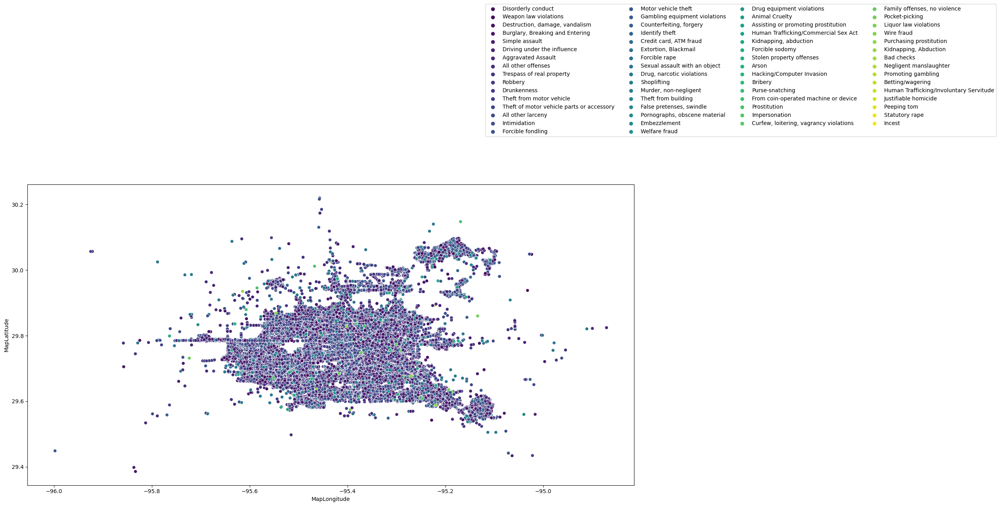

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x='MapLongitude',y='MapLatitude', marker = 'o',data=data_2022,hue='NIBRS Description', palette='viridis')
plt.legend(bbox_to_anchor =(0.75, 1.15), ncol = 4.0)

In [ ]:
#houston_map = folium.Map(location=[29.7604, -95.3698], zoom_start=10)  # Houston's coordinates
#folium.Marker( location=[29.844355, -95.473227 ], fill_color='#43d9de', radius=8 ).add_to( houston_map )
#houston_map

## **<font color='teal'> Crime Locations on Houston Map**

In [ ]:

import folium

# Create an empty set to store the coordinates
coordinates = set()
data_2022=data_2022[0:100000]
# Iterate through the DataFrame rows and add valid coordinates to the set
for row in data_2022.values:
    latitude = row[data_2022.columns.get_loc('MapLatitude')]
    longitude = row[data_2022.columns.get_loc('MapLongitude')]

    # Check if latitude and longitude are not NaN
    if not pd.isnull(latitude) and not pd.isnull(longitude):
        coordinates.add((latitude, longitude))

# Create a map centered on Houston, Texas
houston_map = folium.Map(location=[29.7604, -95.3698], zoom_start=11)  # Houston's coordinates

# Add markers to the map using the coordinates from the set
for coord in coordinates:
    folium.CircleMarker(location=[coord[0], coord[1]], fill_color='#43d9de', radius=1).add_to(houston_map)

# Display the Folium map
houston_map

In [ ]:
import plotly.graph_objects as go

# Create a text column for hover text
data_2022['text'] = data_2022['NIBRS Description']

# Define a custom bounding box for Houston and its surroundings
lon_min, lon_max = -95.7, -94.9  # Adjust the Longitude range for a more zoomed-out view
lat_min, lat_max = 29.4, 30.1  # Adjust the Latitude range for a more zoomed-out view

fig = go.Figure(data=go.Scattergeo(
        locationmode='USA-states',
        lon=data_2022['MapLongitude'],
        lat=data_2022['MapLatitude'],
        text=data_2022['text'],
        mode='markers',
        marker=dict(
            size=8,
            opacity=0.8,
            reversescale=True,
            autocolorscale=False,
            symbol='square',
            line=dict(
                width=1,
                color='rgba(102, 102, 102)'
            ),
            colorscale='Blues',
            cmin=0,
            #color=data_2022['NIBRS Description'] ,
            #cmax=data_2022['NIBRS Description'].max(),
            colorbar_title="Crime Count"
        )))

fig.update_layout(
        title='Crime Locations in Houston Area',
        geo=dict(
            scope='usa',
            projection_type='albers usa',
            center=dict(lon=(lon_min + lon_max) / 2, lat=(lat_min + lat_max) / 2),  # Center of the bounding box
            lonaxis=dict(range=[lon_min, lon_max]),  # Longitude range
            lataxis=dict(range=[lat_min, lat_max]),  # Latitude range
            showland=True,
            landcolor="rgb(250, 250, 250)",
            subunitcolor="rgb(217, 217, 217)",
            countrycolor="rgb(217, 217, 217)",
            countrywidth=0.5,
            subunitwidth=0.5
        ),
    )

fig.show()



In [ ]:
data.shape

(2307150, 19)

# **<font color='teal'> Finding Total number of Crimes in each City**

In [ ]:
a=data['Street Name'].value_counts().rename('Total_number_of_Crime')
b = (data['Street Name'].value_counts(normalize = True)*100).rename('distribution') # normalisation of the classes
tem1 = pd.concat([a,b], axis = 1)
tem1.head(20)

,Total_number_of_Crime,distribution
WESTHEIMER,63948,2.771733
GULF,32830,1.422968
NORTH,29658,1.285483
GESSNER,28907,1.252932
RICHMOND,28799,1.248251
MAIN,24826,1.076047
KATY,23620,1.023774
BISSONNET,22191,0.961836
SAM HOUSTON,22121,0.958802
SOUTHWEST,21278,0.922264


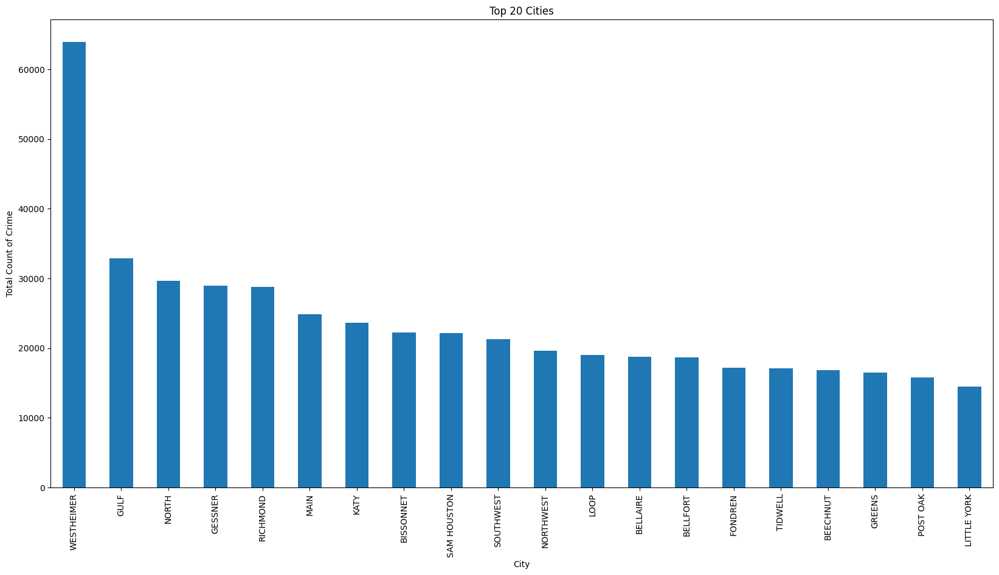

In [ ]:
# Get the top 20 values by sorting the DataFrame
top_20 = tem1['Total_number_of_Crime'].nlargest(20)

# Create a bar plot of the top 20 values
top_20.plot(kind='bar', figsize=(20, 10))
plt.title('Top 20 Cities')
plt.xlabel('City')
plt.ylabel('Total Count of Crime')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability

plt.show()

# **<font color='teal'> List of Crime in each city**

In [ ]:
a = data['NIBRS Description'].groupby(data['Street Name']).value_counts().rename('Count')
b = (data['NIBRS Description'].groupby(data['Street Name']).value_counts(normalize = True)*100).rename('Distribution')
tem2 = pd.concat([a,b], axis = 1)
tem2.tail(20)

Count  \
Street Name                                        NIBRS Description                                  
ZORA                                               Theft                                         10   
                                                   All other larceny                              4   
                                                   Burglary, Breaking and Entering                3   
                                                   Robbery                                        3   
                                                   Theft from motor vehicle                       3   
                                                   Aggravated Assault                             2   
                                                   Burglary                                       2   
                                                   Destruction, damage, vandalism                 2   
                                                   Theft of motor vehicle parts or accessory      2   
                                                   Auto Theft                                     1   
                                                   False pretenses, swindle                       1   
                                                   Intimidation                                   1   
                                                   Motor vehicle theft                            1   
                                                   Simple assault                                 1   
                                                   Trespass of real property                      1   
ZORA ST                                            Burglary                                       2   
                                                   Theft                                          1   
ZORA ST                                        ... AutoTheft                                      1   
ZUBIN LANE                                         Theft                                          1   
ZULA                                               AutoTheft                                      1   

                                                                                              Distribution  
Street Name                                        NIBRS Description                                        
ZORA                                               Theft                                         27.027027  
                                                   All other larceny                             10.810811  
                                                   Burglary, Breaking and Entering                8.108108  
                                                   Robbery                                        8.108108  
                                                   Theft from motor vehicle                       8.108108  
                                                   Aggravated Assault                             5.405405  
                                                   Burglary                                       5.405405  
                                                   Destruction, damage, vandalism                 5.405405  
                                                   Theft of motor vehicle parts or accessory      5.405405  
                                                   Auto Theft                                     2.702703  
                                                   False pretenses, swindle                       2.702703  
                                                   Intimidation                                   2.702703  
                                                   Motor vehicle theft                            2.702703  
                                                   Simple assault                                 2.702703  
                                                   Trespass of real property       

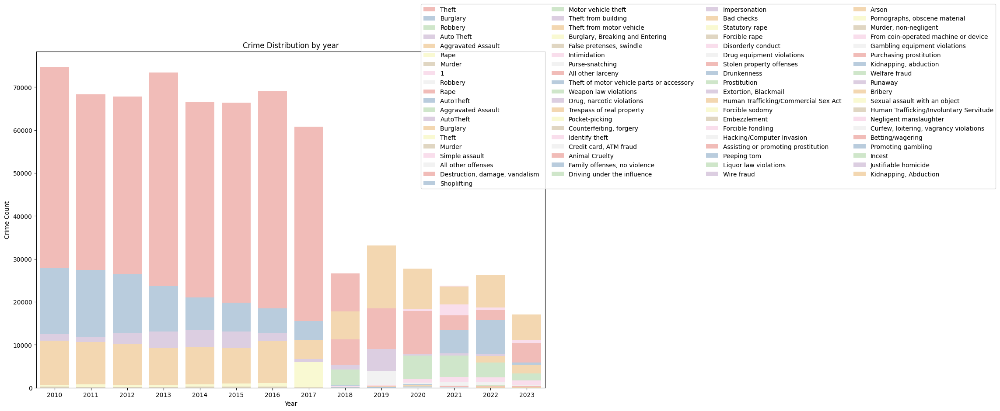

In [ ]:
plt.figure(figsize=(15,10))
sns.countplot(x='year',hue='NIBRS Description', data=data,dodge=False,palette='Pastel1')
plt.title("Crime Distribution by year")
plt.xlabel("Year")
plt.ylabel("Crime Count")
plt.legend(bbox_to_anchor =(0.75, 1.15), ncol = 4.0)
plt.show()

# **<font color='teal'> Total number of crimes in each city (Year wise)**

In [ ]:
f=data['year'].groupby(data['Street Name']).value_counts().rename('Total_Number_of_Crime')
f=pd.DataFrame(f)
f.tail(30)

Total_Number_of_Crime
Street Name                                        year                       
ZOLTOWSKI                                          2010                      2
                                                   2011                      2
                                                   2021                      2
                                                   2015                      1
                                                   2016                      1
                                                   2020                      1
                                                   2022                      1
                                                   2023                      1
ZOLTOWSKI EXIT                                     2015                      1
ZOO CIRCLE                                         2011                      1
                                                   2014                      1
                                                   2015                      1
                                                   2019                      1
                                                   2023                      1
ZOO CIRCLE DR                                      2017                      1
ZORA                                               2012                      8
                                                   2023                      7
                                                   2021                      5
                                                   2016                      4
                                                   2018                      4
                                                   2019                      3
                                                   2010                      2
                                                   2020                      2
                                                   2014                      1
                                                   2022                      1
ZORA ST                                            2018                      2
                                                   2017                      1
ZORA ST                                        ... 2017                      1
ZUBIN LANE                                         2017                      1
ZULA                                               2017                      1

KeyboardInterrupt: ignored

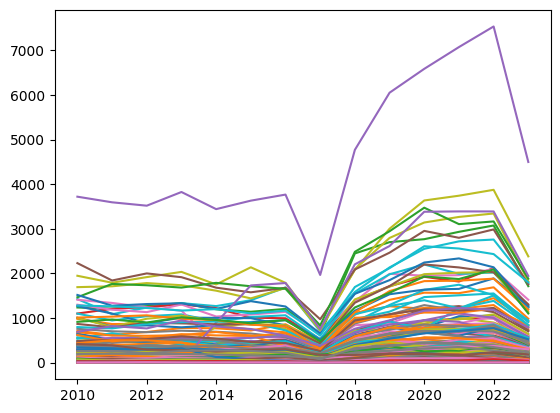

In [ ]:
# Iterate over unique streets (or cities)
for city in data['Street Name'].unique():
    # Filter the data for the current street (city)
    single_city_data = data[data['Street Name'] == city]

    # Group the data by 'year' and count the number of crimes for each year
    yearly_counts = single_city_data['year'].value_counts().sort_index()

    # Plot the data for the current street (city)
    plt.plot(yearly_counts.index, yearly_counts.values, label=city)

# Customize the plot
plt.xlabel('Year')
plt.ylabel('Total Number of Crimes')
plt.title('Total Number of Crimes Over the Years for Different Streets (Cities)')
plt.legend(bbox_to_anchor =(0.75, 1.15), ncol = 4.0)
plt.grid(True)

# Show the plot
plt.show();

# **<font color='teal'> Crime Distribution By Street Type**

In [ ]:
a=data['Street Type'].value_counts().rename('Total')
b = (data['Street Type'].value_counts(normalize = True)*100).rename('distribution') # normalisation of the classes
tem = pd.concat([a,b], axis = 1)
tem.head(20)

,Total,distribution
ST,509835,23.070511
DR,487763,22.071733
RD,402385,18.208298
-,254512,11.516906
FWY,145223,6.571477
BLVD,136881,6.193993
LN,90759,4.106930
AVE,62376,2.822572
PKWY,56464,2.555049
WAY,13796,0.624282


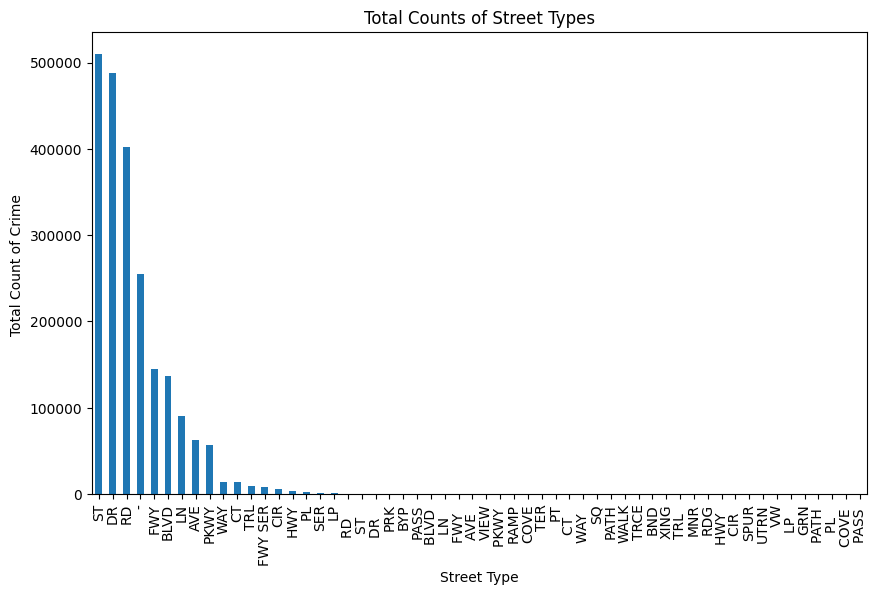

In [ ]:
# Create a bar plot of the total counts
tem['Total'].plot(kind='bar', figsize=(10, 6))
plt.title('Total Counts of Street Types')
plt.xlabel('Street Type')
plt.ylabel('Total Count of Crime ')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability

plt.show()